Aggie, I wanted to make something cute for you with what I've learned from my classes. Happy two months. <br>-Andrew.

In [14]:
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

In [26]:
image_list = ['thumbnail_IMG_2422.jpg', 'thumbnail_IMG_2424.jpg', 'thumbnail_IMG_2503.jpg', 'thumbnail_IMG_2506.jpg', 'thumbnail_IMG_2510.jpg']

car = Image.open(image_list[0])
#car = car.rotate(90, expand=True)

#plt.figure(figsize = (15,8))
#plt.imshow(car)
#plt.axis('off')

car_array = np.asarray(car)
car_array = car_array.copy()
car_red, car_green, car_blue = car_array[:,:,0], car_array[:,:,1], car_array[:,:,2]

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1009x1792 at 0x214F8A4EAD0>


In [16]:
def sepia_filter(r,g,b):
    sepia_r = .393*r + .769*g + .189*b
    sepia_g = .349*r + .686*g + .168*b
    sepia_b = .272*r + .534*g + .131*b
    
    sepia_r = np.clip(sepia_r, 0, 255).astype(np.uint8)
    sepia_g = np.clip(sepia_g, 0, 255).astype(np.uint8)
    sepia_b = np.clip(sepia_b, 0, 255).astype(np.uint8)


    return sepia_r, sepia_g, sepia_b

In [24]:
def makeImageFromRGB(red_array, green_array, blue_array):
    
    image = np.dstack((red_array,green_array,blue_array)).astype(np.uint8)
    plt.figure(figsize = (15,15))
    plt.imshow(image)
    plt.axis('off')

In [18]:
sepia_car = sepia_filter(car_red,car_green,car_blue)
makeImageFromRGB(sepia_car[0],sepia_car[1],sepia_car[2])
plt.clf()

<Figure size 1000x1000 with 0 Axes>

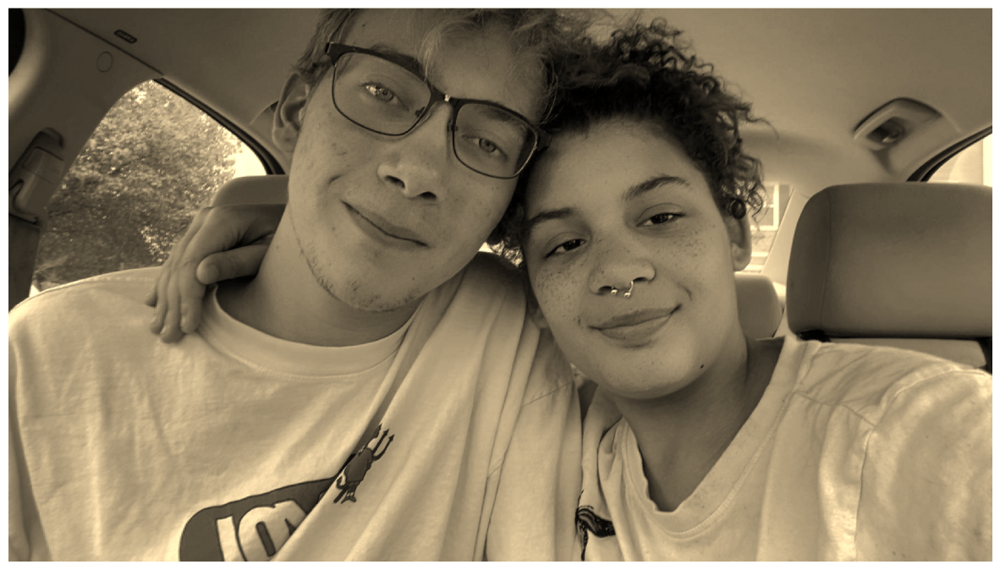

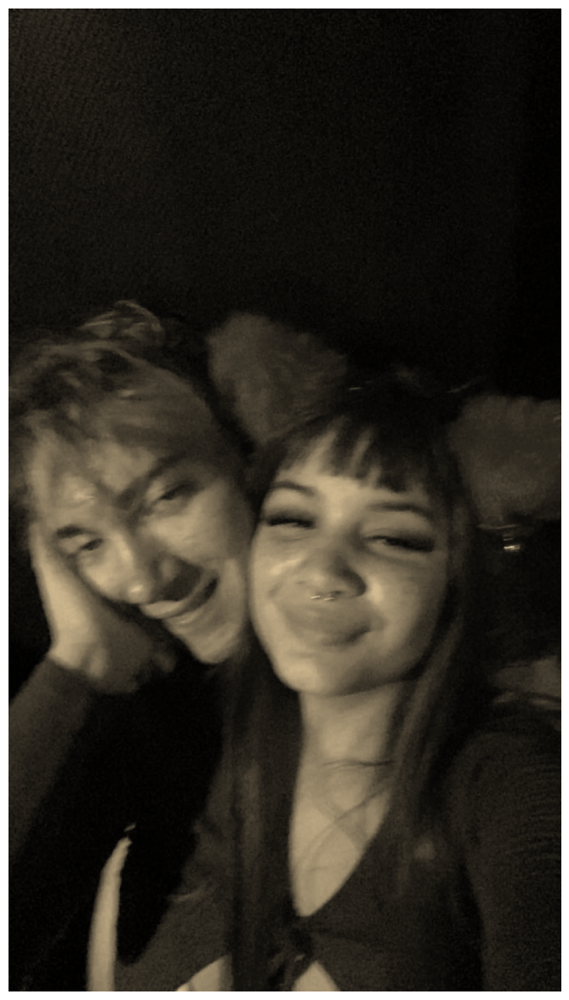

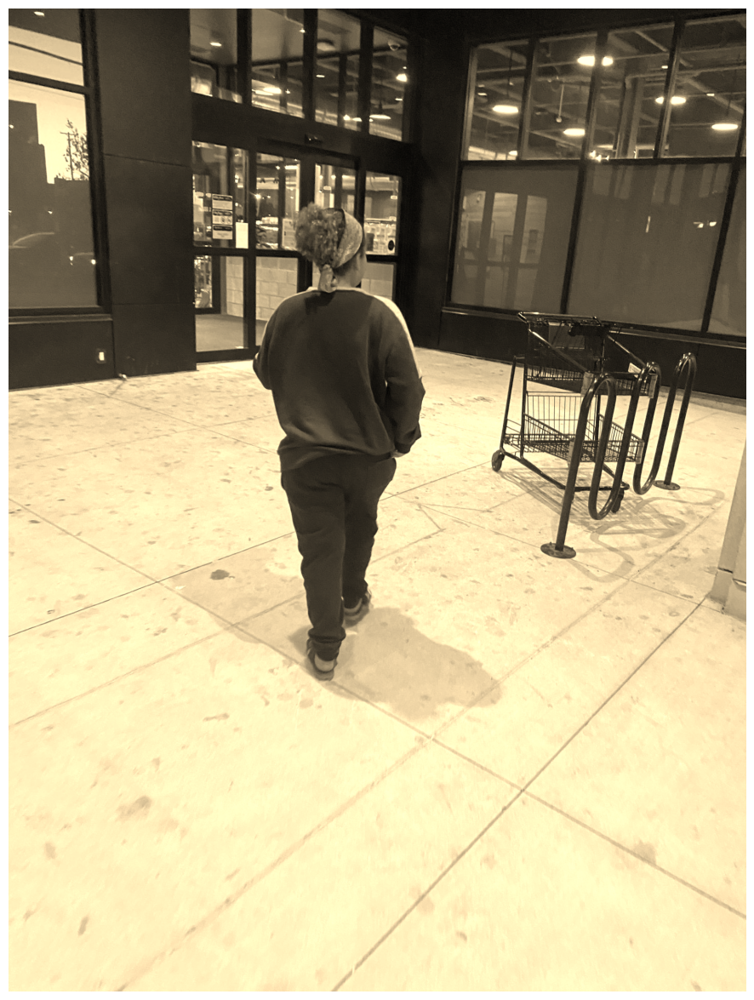

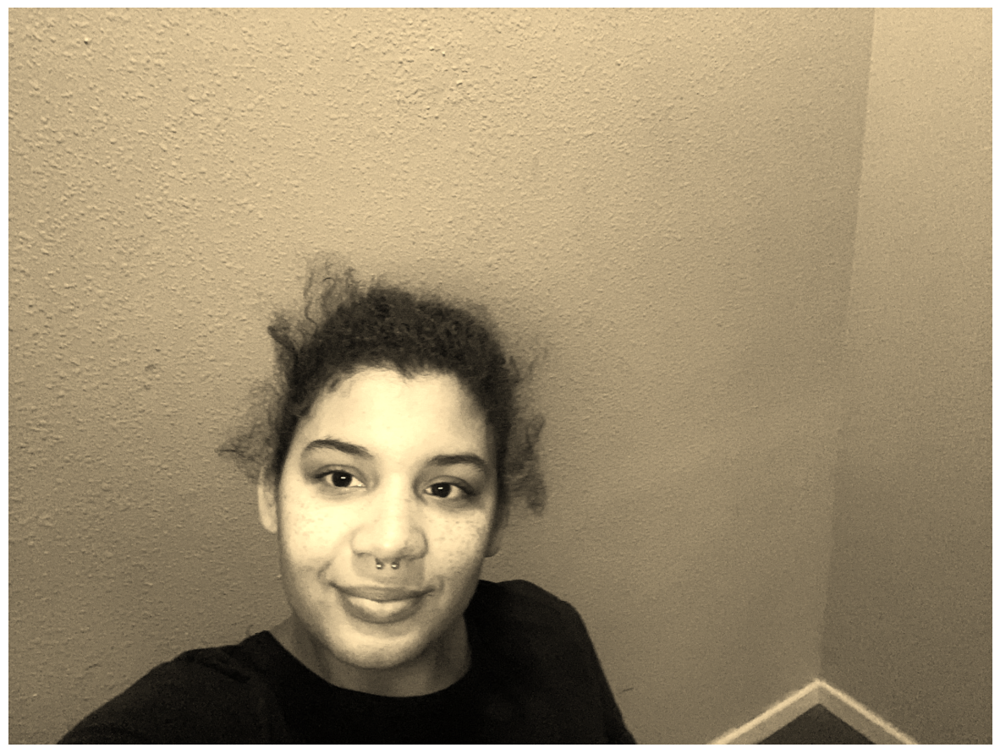

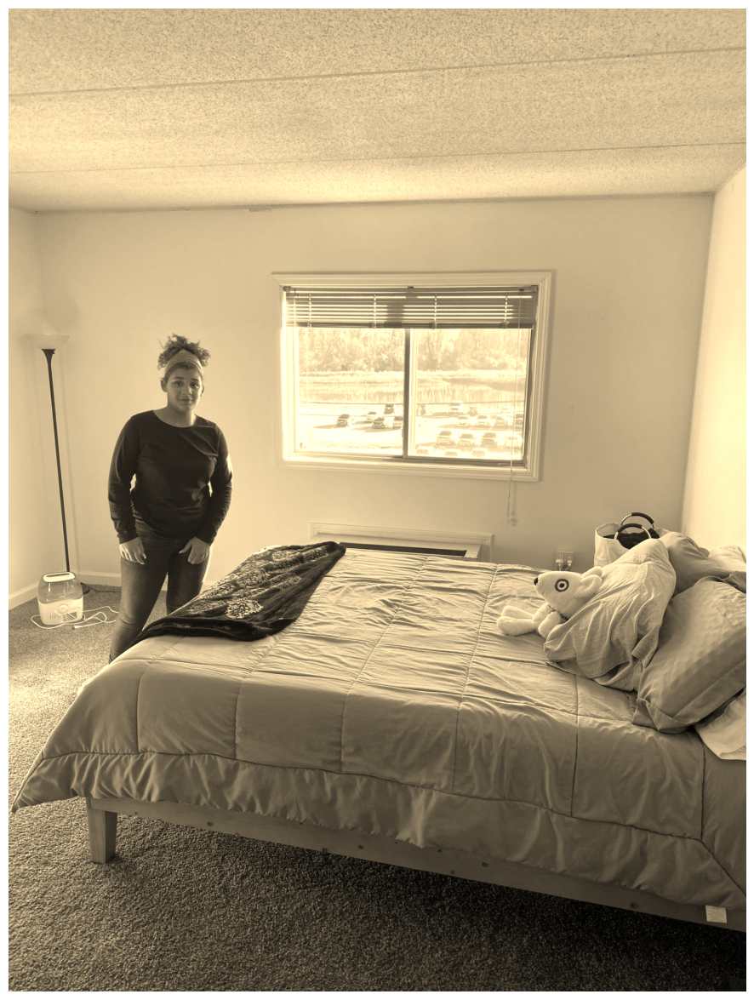

In [28]:
for i in image_list:
    val = Image.open(i)
    
    if i == image_list[0]:
        val = val.rotate(90, expand=True)


    #plt.figure(figsize = (15,8))
    #plt.imshow(val)
    #plt.axis('off')

    val_array = np.asarray(val)
    val_array = val_array.copy()
    val_red, val_green, val_blue = val_array[:,:,0], val_array[:,:,1], val_array[:,:,2]
    r,g,b = sepia_filter(val_red, val_green, val_blue)
    makeImageFromRGB(r,g,b)

Those pictures seem nice. Lets see what other filters we can apply

In [20]:
import numpy as np

def increase_saturation(r,g,b,saturation_factor=1):
    ## Ensure the image is represented as a NumPy array
    #image = np.asarray(image, dtype=np.float32)

    ## Normalize the RGB values to the range [0, 1]
    #image /= 255.0

    ## Separate the RGB channels
    #r, g, b = image[:, :, 0], image[:, :, 1], image[:, :, 2]

    # Calculate the grayscale intensity
    gray = 0.299 * r + 0.587 * g + 0.114 * b

    # Calculate the color difference from grayscale
    dr, dg, db = r - gray, g - gray, b - gray

    # Adjust the color channels to increase saturation
    r = gray + dr * saturation_factor
    g = gray + dg * saturation_factor
    b = gray + db * saturation_factor
    
    # Clip values to stay within the valid range [0, 1]
    r = np.clip(r, 0, 255)
    g = np.clip(g, 0, 255)
    b = np.clip(b, 0, 255)

    return r,g,b

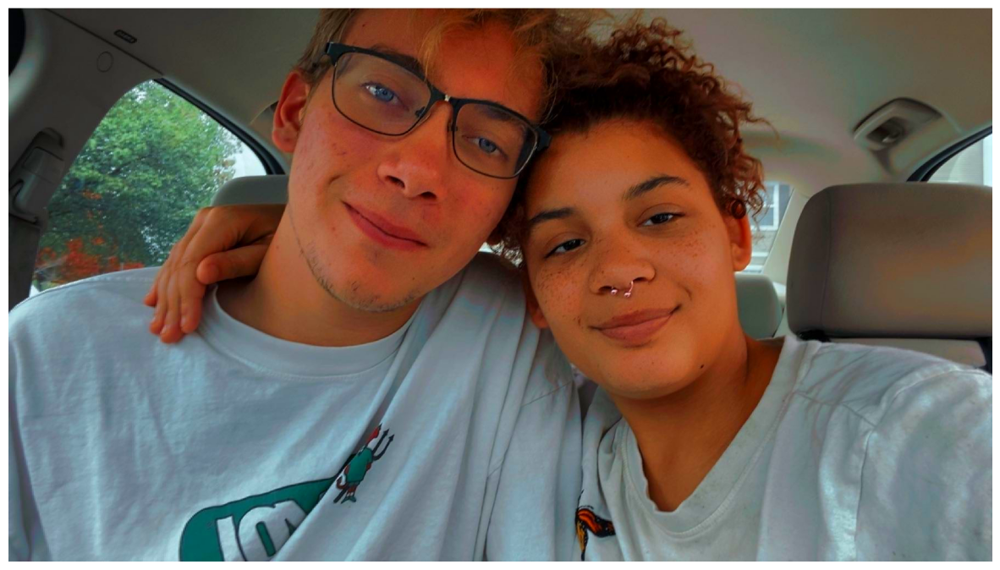

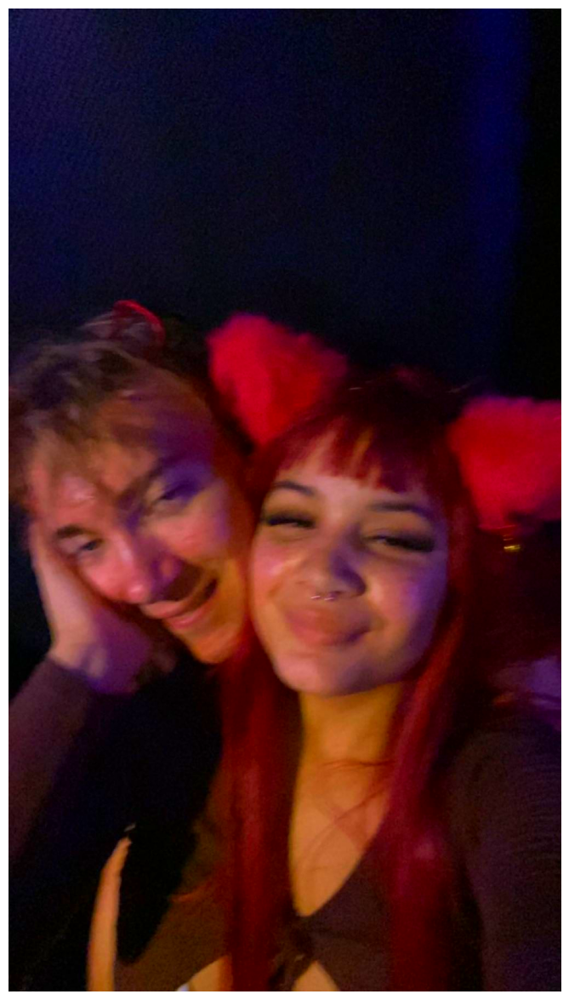

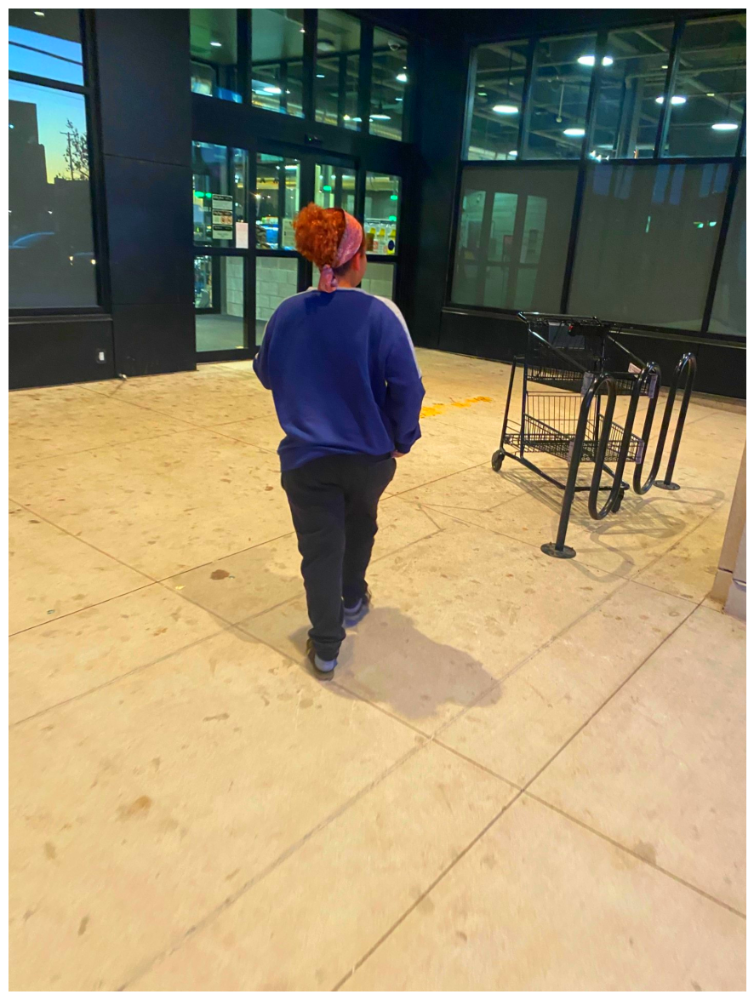

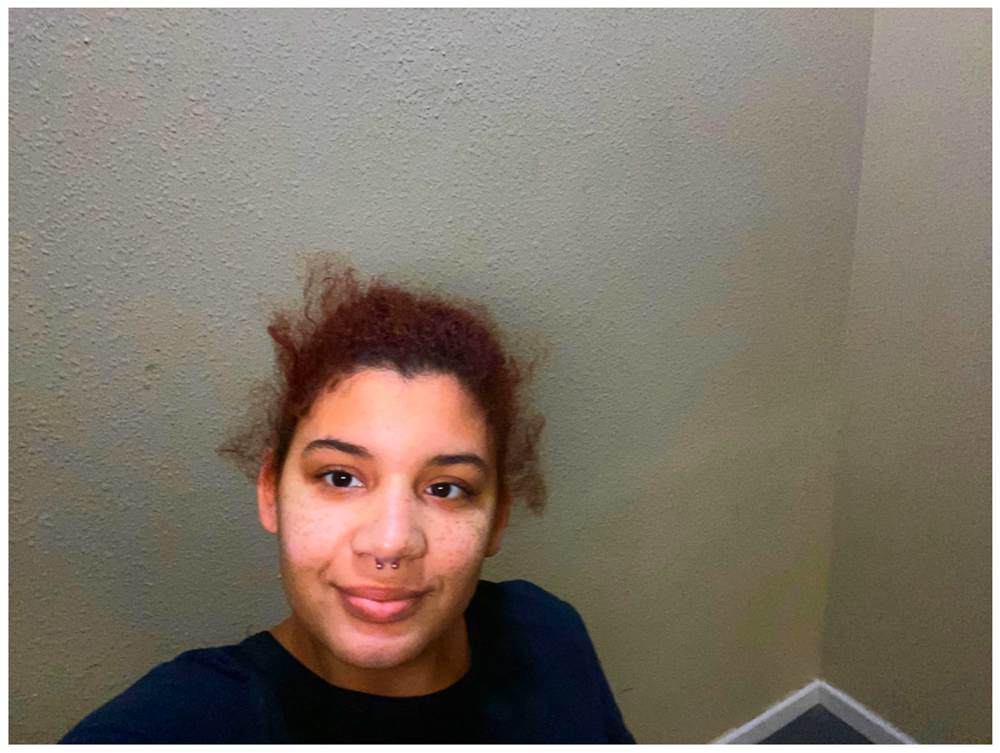

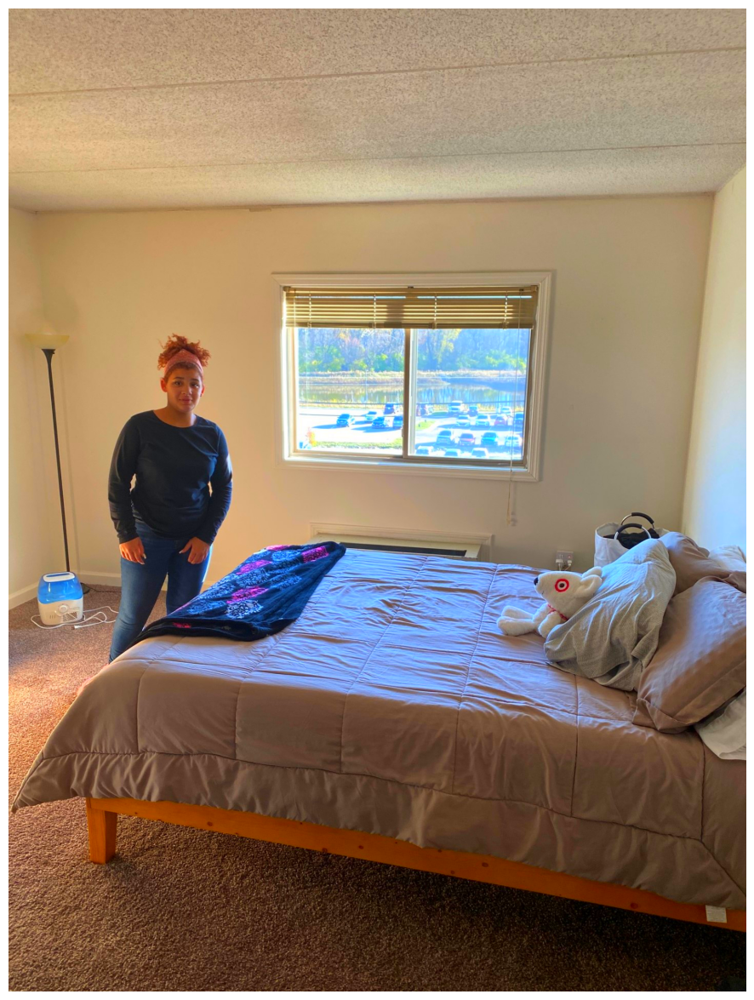

In [30]:
for i in image_list:
    val = Image.open(i)
    
    if i == image_list[0]:
        val = val.rotate(90, expand=True)


    #plt.figure(figsize = (15,8))
    #plt.imshow(car)
    #plt.axis('off')

    val_array = np.asarray(val)
    val_array = val_array.copy()
    val_red, val_green, val_blue = val_array[:,:,0], val_array[:,:,1], val_array[:,:,2]
    

    r,g,b = increase_saturation(val_red, val_green, val_blue, 2)
    makeImageFromRGB(r,g,b)

lets see what happens when we put the two filters together!

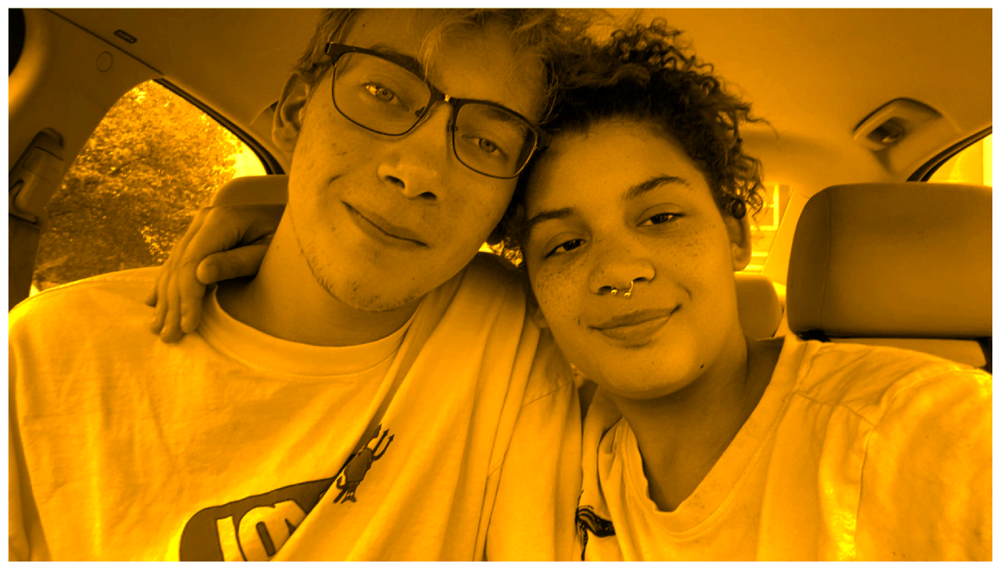

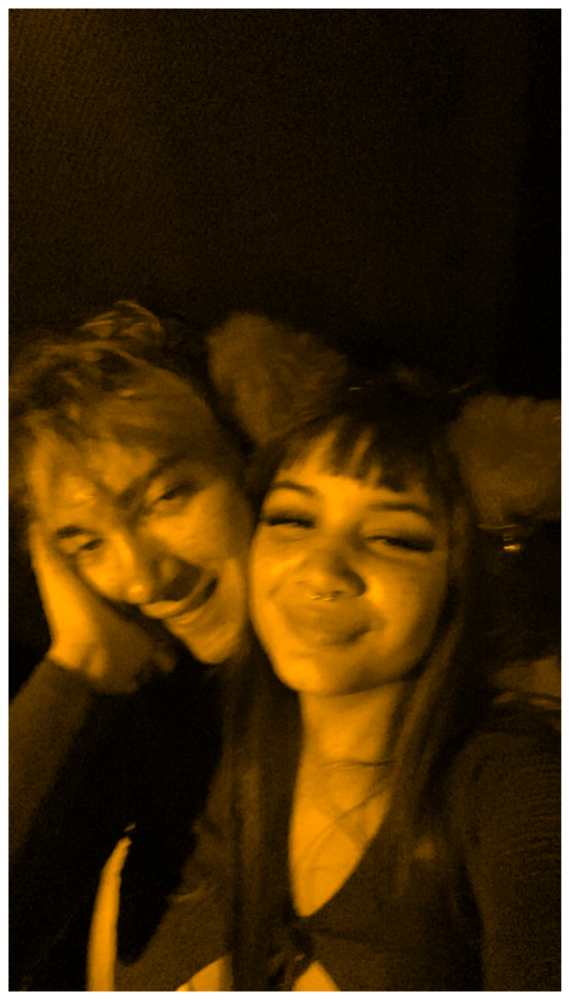

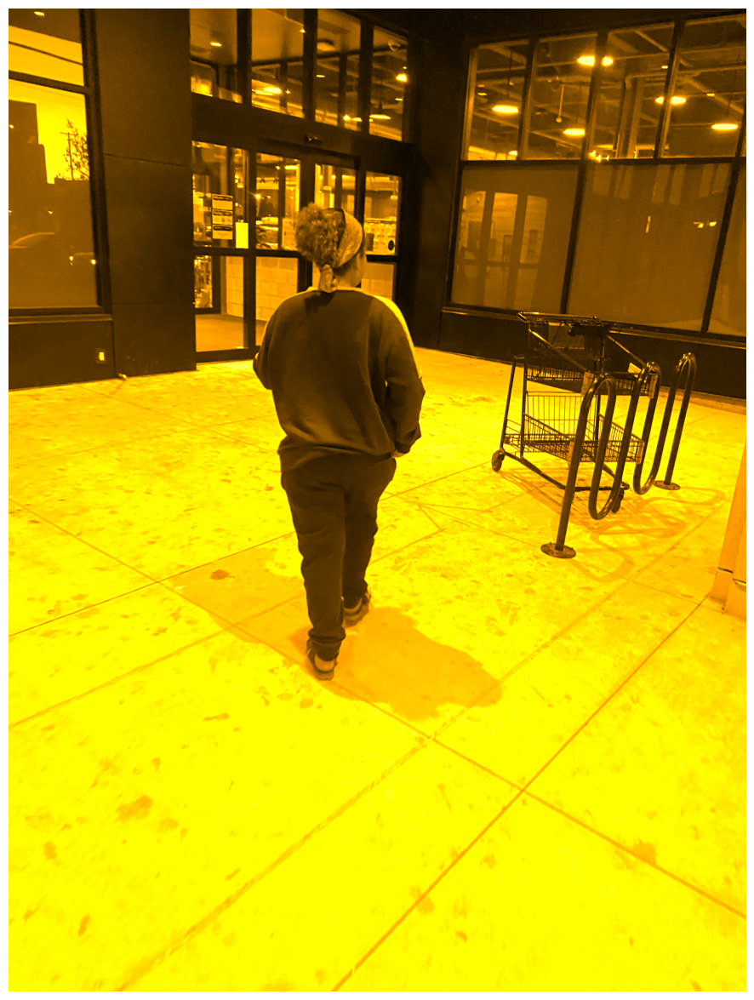

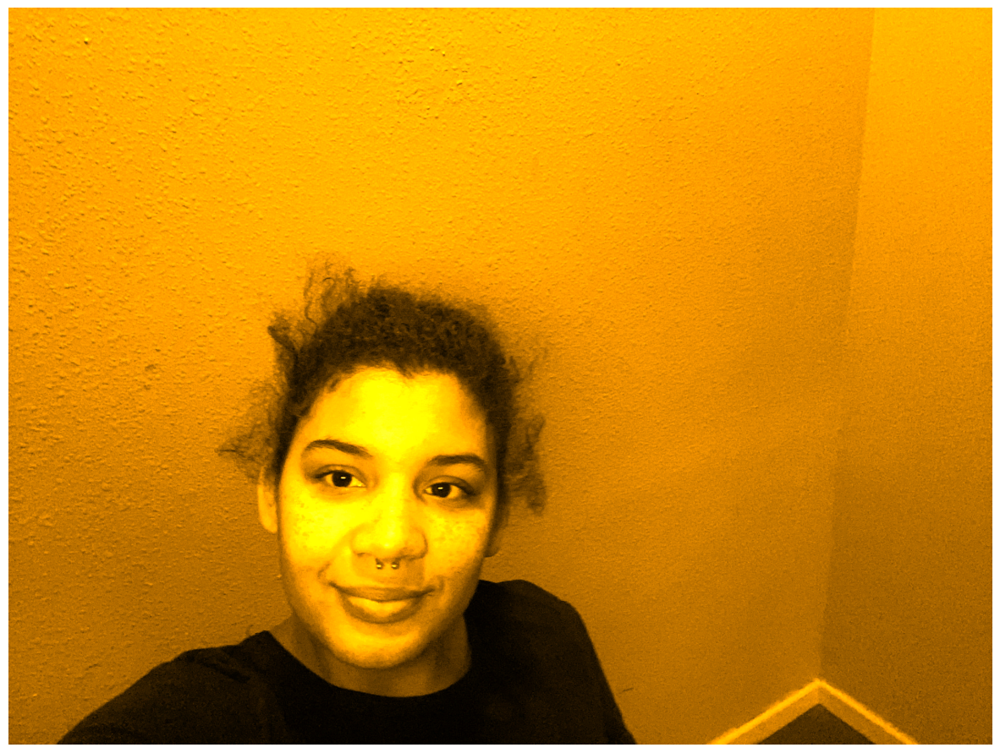

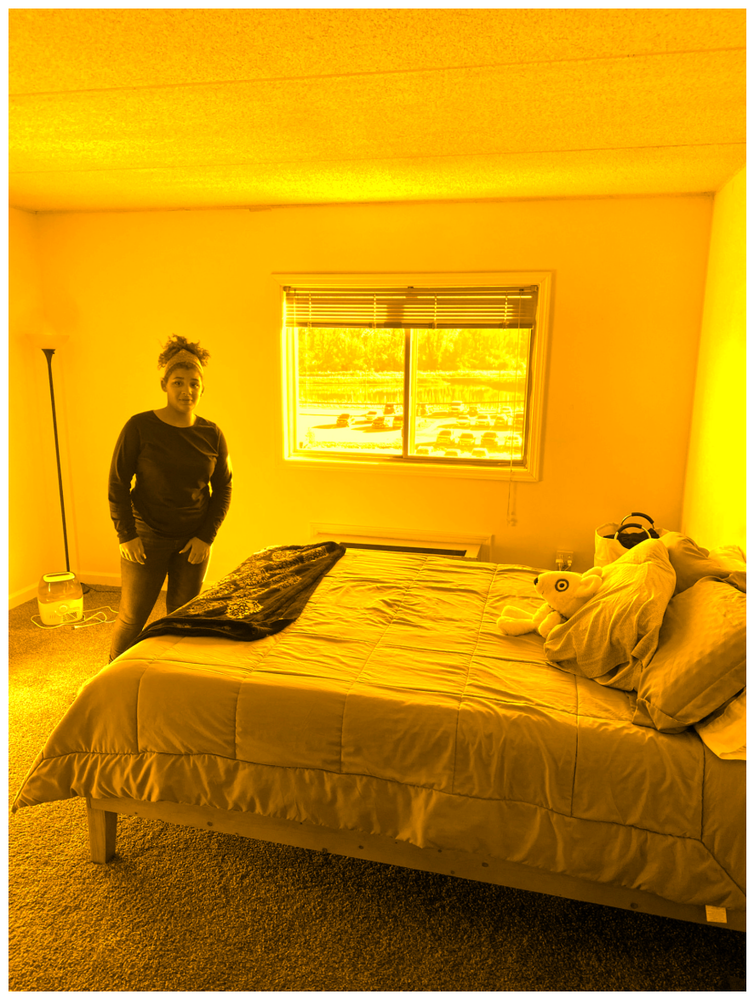

In [36]:
for i in image_list:
    val = Image.open(i)
    
    if i == image_list[0]:
        val = val.rotate(90, expand=True)


    #plt.figure(figsize = (15,8))
    #plt.imshow(car)
    #plt.axis('off')

    val_array = np.asarray(val)
    val_array = val_array.copy()
    val_red, val_green, val_blue = val_array[:,:,0], val_array[:,:,1], val_array[:,:,2]
    

    r,g,b = sepia_filter(val_red, val_green, val_blue)
    r,g,b = increase_saturation(r,g,b, 5)
    makeImageFromRGB(r,g,b)